# Debugging Sidebands_NF.py

In [22]:
import os

sidebands = False
Date = "Jul_24"
num_epochs_MC = 11
num_epochs_DATA =6
extra_info = "_TEST_no_sidebands_switch_single_"
switch_mask = True
double = False
if(double):
    latent_dim = 71 * 2
else:
    latent_dim = 71
num_layers = 32

In [23]:
lambda_prefix = "/hpc/group/vossenlab/rck32/Lambda-GNNs"
loss_dir = lambda_prefix + "/plots/NF_loss/sideband_double_" + Date
loss_MC_path = loss_dir + "/"+ extra_info + "MCloss.jpeg"
loss_DATA_path = loss_dir +"/"+ extra_info + "DATAloss.jpeg"

model_dir = lambda_prefix + "/models/NF_sidebands_double/" + Date
model_MC_path = model_dir +"/"+ extra_info + "MC.pth"
model_DATA_path = model_dir +"/"+ extra_info + "DATA.pth"

smearing_dir = lambda_prefix + "/plots/NF_sidebands/smear/" + Date
smearing_path = smearing_dir + "/"+ extra_info + "sideband_double_smear.jpeg"

histo_dir = lambda_prefix + "/plots/NF_sidebands/histos/" + Date
histo_path = histo_dir + "/"+ extra_info + "mass_spectrum.jpeg"

FOM_pure_dir = lambda_prefix + "/plots/NF_sidebands/FOM_pure/" + Date
FOM_pure_path = FOM_pure_dir + "/"+ extra_info + "FOM_pure_plot.jpeg"

classifier_loss_dir = lambda_prefix + "/plots/NF_sidebands/Class_loss/" + Date
classifier_loss_loc = classifier_loss_dir + "/"+ extra_info + "train_classifier_loss.jpeg"

dirs = [loss_dir,model_dir,smearing_dir,histo_dir,FOM_pure_dir,classifier_loss_dir]

for this_dir in dirs:
    if(not os.path.isdir(this_dir)):
        os.mkdir(this_dir)



import normflows as nf
from normflows import flows
## Standard libraries
import math
import time

import numpy as np

## Imports for plotting
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['lines.linewidth'] = 2.0

## PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as tdata
import torch.optim as optim

import dgl #NOTE: for dgl.batch and dgl.unbatch
from dgl import save_graphs, load_graphs
from dgl.data import DGLDataset
from dgl.dataloading import GraphDataLoader
from dgl.data.utils import save_info, load_info, Subset

from tqdm import tqdm

# Ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

import scipy.optimize as opt
from scipy.stats import crystalball

# Fetching the device that will be used throughout this notebook
device = torch.device("cpu") if not torch.cuda.is_available() else torch.device("cuda:0")
print("Using device", device)

#custom imports
from utils import load_graph_dataset, train, evaluate, GraphDataset, get_graph_dataset_info
from models import GIN, HeteroGIN
from NF_utils import Latent_data, create_latent_data, get_masked_affine, transform, train,plot_loss, test,plot_9_histos, plot_UMAP_sidebyside,plot_UMAP_overlay, transform_double, NFClassifier,train_classifier,test_classifier_data

'''                                              '''
'''     SETTING UP LATENT SPACE REPRESENTATION   '''
'''                                              '''

#Number of graphs in each
# DATA_max_events = 149090
DATA_max_events = 249090
MC_max_events = 141118

# Data and MC both have the same prefix
prefix = "/hpc/group/vossenlab/mfm45/.dgl/"

# MC inside Lambda_train_matched_jobs_outbending_cache_bg50nA_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized
MCdataset = "Lambda_train_matched_jobs_outbending_cache_bg50nA_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized"

# Data inside data_jobs_rga_fall2018_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized
DATAdataset = "data_jobs_rga_fall2018_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized"

max_events = 1e5
split = 0.1
nlayers = 2
nmlp = 3
hdim = 64
nclasses, nfeatures, nfeatures_edge = get_graph_dataset_info(dataset=MCdataset, prefix=prefix)
dropout = 0.8
learn_eps = False
batch = 256
indices = None
nworkers = 0
npooling = "max"
gpooling = "max"
torch.manual_seed(0)

#select model
extractor = GIN(nlayers, nmlp, nfeatures,
            hdim, nclasses, dropout, learn_eps, npooling, gpooling).to(device)
extractor.load_state_dict(torch.load("logs/model_weights",map_location=device))

num_samples = 100
training_data_DATA = create_latent_data(DATAdataset, extractor,num_samples = num_samples, max_events = DATA_max_events, double = double)
training_data_MC = create_latent_data(MCdataset, extractor,num_samples = num_samples, max_events = MC_max_events, double = double)

testing_data_DATA = create_latent_data(DATAdataset, extractor, mode = "test",num_samples = num_samples, max_events = DATA_max_events, double = double)
testing_data_MC = create_latent_data(MCdataset, extractor, mode = "test",num_samples = num_samples, max_events = MC_max_events, double = double)

val_data_DATA = create_latent_data(DATAdataset, extractor, mode = "val",num_samples = num_samples, max_events = DATA_max_events, double = double)
val_data_MC = create_latent_data(MCdataset, extractor, mode = "val",num_samples = num_samples, max_events = MC_max_events, double = double)

sb_training_DATA = Latent_data(torch.clone(training_data_DATA.data), torch.clone(training_data_DATA.labels), sidebands = sidebands)
sb_training_DATA.set_mass(torch.clone(training_data_DATA.mass))
sb_training_DATA.get_sidebands()
sb_training_DATA.set_batch_size(100)

sb_training_MC = Latent_data(torch.clone(training_data_MC.data), torch.clone(training_data_MC.labels), sidebands = sidebands)
sb_training_MC.set_mass(torch.clone(training_data_MC.mass))
sb_training_MC.get_sidebands()
sb_training_MC.set_batch_size(100)


sb_testing_DATA = Latent_data(torch.clone(testing_data_DATA.data), torch.clone(testing_data_DATA.labels), sidebands = sidebands)
sb_testing_DATA.set_mass(torch.clone(testing_data_DATA.mass))
sb_testing_DATA.get_sidebands()
sb_testing_DATA.set_batch_size(100)

sb_testing_MC = Latent_data(torch.clone(testing_data_MC.data), torch.clone(testing_data_MC.labels), sidebands = sidebands)
sb_testing_MC.set_mass(torch.clone(testing_data_MC.mass))
sb_testing_MC.get_sidebands()
sb_testing_MC.set_batch_size(100)

sb_val_DATA = Latent_data(torch.clone(val_data_DATA.data), torch.clone(val_data_DATA.labels), sidebands = sidebands)
sb_val_DATA.set_mass(torch.clone(val_data_DATA.mass))
sb_val_DATA.get_sidebands()
sb_val_DATA.set_batch_size(100)

sb_val_MC = Latent_data(torch.clone(val_data_MC.data), torch.clone(val_data_MC.labels), sidebands = sidebands)
sb_val_MC.set_mass(torch.clone(val_data_MC.mass))
sb_val_MC.get_sidebands()
sb_val_MC.set_batch_size(100)

Using device cuda:0
No mode given, defaulting to training

No mode given, defaulting to training



100%|██████████| 672/672 [01:08<00:00,  9.86it/s]


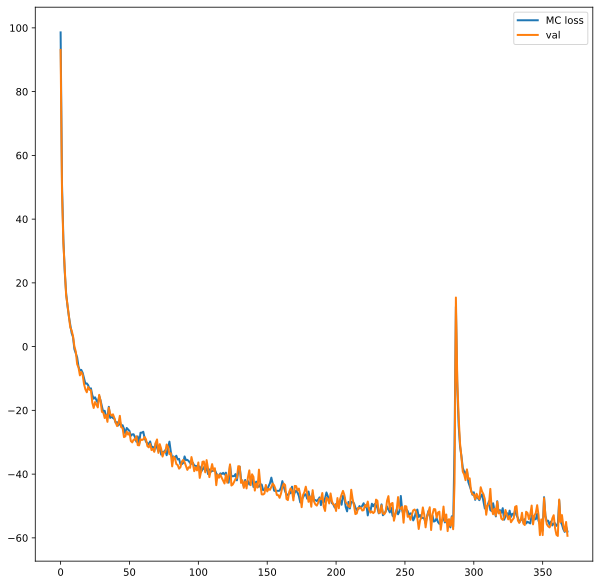

Lowest Loss: -58.12558994293213


100%|██████████| 1566/1566 [02:57<00:00,  8.82it/s]


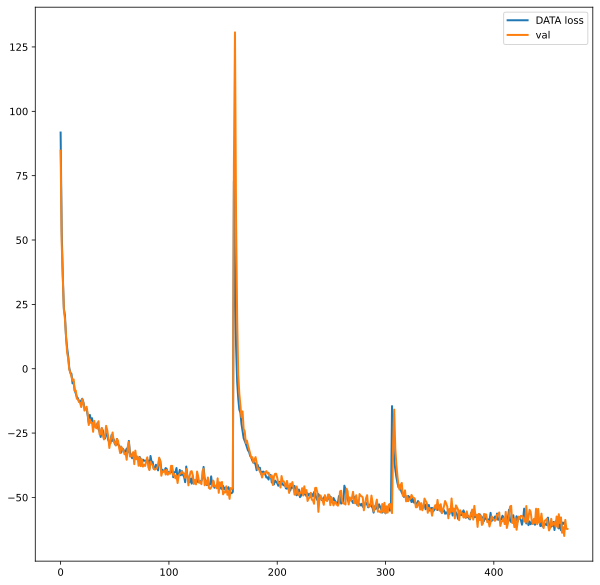

Lowest Loss: -62.739871978759766


'\nEND CODE TO LOAD MODEL\n'

In [24]:
'''
BELOW IS THE CODE TO TRAIN MODEL
'''

# SETTING UP DATA MODEL

masked_affine_flows_train_DATA = get_masked_affine(latent_dim = latent_dim,num_layers = num_layers,alternate_mask = True,hidden_dim = latent_dim * 2, switch_mask = switch_mask)
distribution_DATA = nf.distributions.DiagGaussian(latent_dim, trainable = False)
masked_affine_model_DATA = nf.NormalizingFlow(q0=distribution_DATA, flows=masked_affine_flows_train_DATA)
DATA_model = masked_affine_model_DATA.to(device)

# SETTING UP MC MODEL

masked_affine_flows_train_MC = get_masked_affine(latent_dim = latent_dim,num_layers = num_layers,alternate_mask = True, hidden_dim = latent_dim * 2, switch_mask = switch_mask)
distribution_MC = nf.distributions.DiagGaussian(latent_dim, trainable = False)
masked_affine_model_MC = nf.NormalizingFlow(q0=distribution_MC, flows=masked_affine_flows_train_MC)
MC_model = masked_affine_model_MC.to(device)

# TRAINING MC
loss_hist_MC, val_hist_MC, full_loss_hist_MC, full_val_hist_MC = train(sb_training_MC, MC_model, val = True, val_data = sb_val_MC, num_epochs = num_epochs_MC, compact_num = 20, show_progress = True)
plot_loss(loss_hist_MC, label = "MC loss",plot_val = True, val_loss_hist = val_hist_MC, save = True, save_loc = loss_MC_path)
MC_model.save(model_MC_path)

# TRAINING DATA
loss_hist_DATA, val_hist_DATA, full_loss_hist_DATA, full_val_hist_DATA = train(sb_training_DATA, DATA_model, val = True, val_data = sb_val_DATA, num_epochs = num_epochs_DATA, compact_num = 20, show_progress = True)
plot_loss(loss_hist_DATA, label = "DATA loss", plot_val = True, val_loss_hist = val_hist_DATA, save = True, save_loc = loss_DATA_path)
DATA_model.save(model_DATA_path)

'''
ABOVE IS CODE TO TRAIN MODEL

BELOW IS CODE TO LOAD MODEL
'''
# july_19_models = lambda_prefix + "/models/NF_sidebands_double/July_19/"
# #Using model we trained earlier:
# masked_affine_flows_train_MC = get_masked_affine(latent_dim = latent_dim,num_layers = num_layers,alternate_mask = alternate, hidden_dim = latent_dim * 2, switch_mask = switch_mask)
# distribution_MC = nf.distributions.DiagGaussian(latent_dim, trainable = False)
# masked_affine_model_MC = nf.NormalizingFlow(q0=distribution_MC, flows=masked_affine_flows_train_MC)
# masked_affine_model_MC.load(july_19_models + "MC.pth")
# MC_model = masked_affine_model_MC.to(device)

# #Using model we trained earlier:
# masked_affine_flows_train_DATA = get_masked_affine(latent_dim = latent_dim,num_layers = num_layers,alternate_mask = alternate,hidden_dim = latent_dim * 2, switch_mask = switch_mask)
# distribution_DATA = nf.distributions.DiagGaussian(latent_dim, trainable = False)
# masked_affine_model_DATA = nf.NormalizingFlow(q0=distribution_DATA, flows=masked_affine_flows_train_DATA)
# masked_affine_model_DATA.load(july_19_models + "DATA.pth")
# DATA_model = masked_affine_model_DATA.to(device)

'''
END CODE TO LOAD MODEL
'''

In [25]:
# Testing MC
test(sb_testing_MC, MC_model, data_type = "MC", show_progress = True)
# Testing DATA
test(sb_testing_DATA, DATA_model, data_type = "DATA", show_progress = True)

#Transformations

transformed_latent_MC = transform(testing_data_MC, MC_model,show_progress = True)
transformed_latent_DATA = transform(testing_data_DATA, DATA_model,show_progress = True)

transformed_latent_train_MC = transform(training_data_MC, MC_model,show_progress = True)
transformed_latent_train_DATA = transform(training_data_DATA, DATA_model,show_progress = True)
transformed_latent_val_MC = transform(val_data_MC, MC_model,show_progress = True)
transformed_latent_val_DATA = transform(val_data_DATA, DATA_model,show_progress = True)

# From above plotting: <transformed_latent_DATA> is the tensor with normalized DATA
# Now need to transform it back to MC version of latent space
transformed_latent_DATA_obj = Latent_data(transformed_latent_DATA,testing_data_DATA.labels)
transformed_latent_DATA_obj.set_batch_size(num_samples)
transformed_latent_MC_obj = Latent_data(transformed_latent_MC,testing_data_MC.labels)
transformed_latent_MC_obj.set_batch_size(num_samples)

transformed_latent_train_DATA_obj = Latent_data(transformed_latent_train_DATA,training_data_DATA.labels)
transformed_latent_train_DATA_obj.set_batch_size(num_samples)
transformed_latent_train_MC_obj = Latent_data(transformed_latent_train_MC,training_data_MC.labels)
transformed_latent_train_MC_obj.set_batch_size(num_samples)

transformed_latent_val_DATA_obj = Latent_data(transformed_latent_val_DATA,val_data_DATA.labels)
transformed_latent_val_MC_obj = Latent_data(transformed_latent_val_MC,val_data_MC.labels)

full_pass_DATA = transform(transformed_latent_DATA_obj, MC_model, reverse = False,show_progress = True)
full_pass_DATA_obj = Latent_data(full_pass_DATA, testing_data_DATA.labels)
full_pass_DATA_obj.set_batch_size(num_samples)

full_pass_train_DATA = transform(transformed_latent_train_DATA_obj, MC_model, reverse = False,show_progress = True)
full_pass_train_DATA_obj = Latent_data(full_pass_train_DATA, training_data_DATA.labels)
full_pass_train_DATA_obj.set_batch_size(num_samples)

100%|██████████| 84/84 [00:01<00:00, 54.10it/s]


MC average loss: -57.13534164428711


100%|██████████| 195/195 [00:03<00:00, 55.37it/s]


DATA average loss: -58.646873474121094


100%|██████████| 1992/1992 [00:32<00:00, 61.59it/s]


In [26]:
#Need to get rid of NAN events

plot_fpd = torch.clone(full_pass_train_DATA)
plot_train_data = torch.clone(training_data_DATA.data)
for i in range(len(plot_fpd)):
    for j in range(71):
        if(np.isnan(plot_fpd[i,j])):
            plot_fpd[i,0] = 99999
            plot_train_data[i,0] = 99999
            break
plot_fpd = plot_fpd[plot_fpd[:,0] != 99999]
plot_train_data = plot_train_data[plot_train_data[:,0] != 99999]

#Calculate smearing matrix for data -> fullpass

fig, ((ax11,ax12,ax13),(ax21,ax22,ax23),(ax31,ax32,ax33)) = plt.subplots(3,3,figsize = (12,12))
fig.suptitle("NF Smearing Matrices"+ extra_info)
axlist = [ax11,ax12,ax13,ax21,ax22,ax23,ax31,ax32,ax33]
index_list = [0,1,2,9,10,15,16,17,18]
for i in range(9):
    x = torch.Tensor.numpy(plot_train_data[:,index_list[i]])
    y = torch.Tensor.numpy(plot_fpd[:,index_list[i]])
    axlist[i].hist2d(x,y,bins = 100, cmap = plt.cm.jet)
# plt.show()
plt.savefig(smearing_path)

  0%|          | 0/1128 [00:08<?, ?it/s]

Finished Training


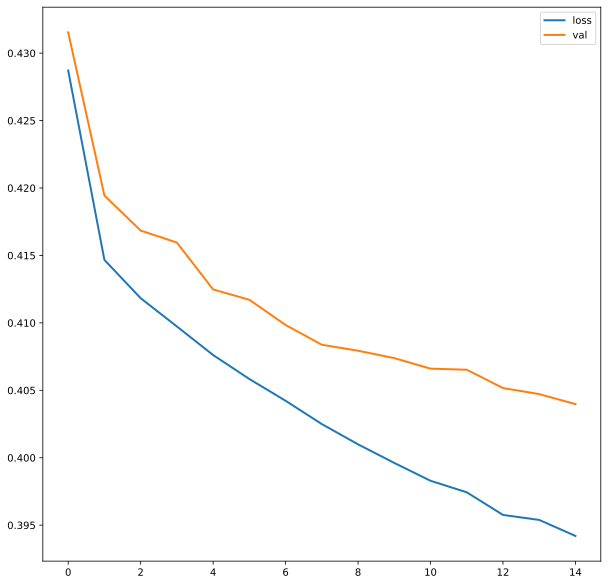

Lowest Loss: 0.39419886677241917


100%|██████████| 1128/1128 [00:04<00:00, 274.36it/s]


In [27]:
classifier = NFClassifier(num_layers = 10, input_size = latent_dim, hidden_dim = 400).to(device)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(classifier.parameters(), lr=5e-4, weight_decay=1e-5)
num_epochs_classifier = 15

class_loss_hist, class_val_loss_hist = train_classifier(training_data_MC, classifier, criterion, optimizer, val = True, val_data = val_data_MC, num_epochs = num_epochs_classifier,show_progress = False)

plot_loss(class_loss_hist, plot_val =True, val_loss_hist = class_val_loss_hist, save = True, save_loc = classifier_loss_loc)

probs_DATA_test = test_classifier_data(full_pass_DATA_obj, classifier,ret_probs = True,show_progress = True)
probs_DATA_fp = test_classifier_data(full_pass_train_DATA_obj, classifier,ret_probs = True,show_progress = True)
probs_DATA = test_classifier_data(training_data_DATA, classifier,ret_probs = True,show_progress = True)
probs_MC = test_classifier_data(training_data_MC, classifier,ret_probs = True,show_progress = True)

In [31]:
cut_hist = torch.empty(15,3)
for i in range(15):
    roc_cut = i / 15
    probs_data = plot_train_data
    if(roc_cut == 0):
        argmax_Y = torch.max(probs_data, 1)[1]
    else:
        argmax_Y = torch.tensor([1 if el>roc_cut else 0 for el in probs_data[:,1]],dtype=torch.long)

    masked_mass = argmax_Y * training_data_DATA.mass
    #     signal_mass = argmax_Y * testing_data_DATA.mass
    signal_mass = np.array([])
    for j in range(masked_mass.size()[0]):
        if(masked_mass[j] != 0):
            signal_mass = np.append(signal_mass, masked_mass[j])
    # Define fit function


    low_high = (1.08,1.24)
    bins = 100

    hdata = np.histogram(signal_mass, range=low_high, bins=bins, density=False);
#     hdata = plt.hist(signal_mass, color='tab:orange', alpha=0.5, range=low_high, bins=bins, histtype='stepfilled', density=False, label='signal');

    N, beta, m, loc, scale, A, B, C = 10, 1, 1.112, 1.115, 0.008, np.average(hdata[0][-10:-1]), 37, 1.24
    d_N, d_beta, d_m, d_loc, d_scale, d_A, d_B, d_C = N/0.01, beta/0.1, m/0.1, loc/0.1, scale/0.01, A/10, B/0.1, C/1
    parsMin = [N-d_N, beta-d_beta, m-d_m, loc-d_loc, scale-d_scale, B-d_B]
    parsMax = [N+d_N, beta+d_beta, m+d_m, loc+d_loc, scale+d_scale, B+d_B]

    def func(x, N, beta, m, loc, scale, B, A=A, C=C):
        return N*crystalball.pdf(-x, beta, m, -loc, scale) + A*(1 - B*(x - C)**2)

    def sig(x, N, beta, m, loc, scale):
        return N*crystalball.pdf(-x, beta, m, -loc, scale)

    def bg(x, B, A=A, C=C):
        return A*(1 - B*(x - C)**2)

    optParams, pcov = opt.curve_fit(func, hdata[1][:-1], hdata[0], method='trf', bounds=(parsMin,parsMax))

    x = np.linspace(low_high[0],low_high[1],bins)
    y = hdata[0]

#     plt.plot(x, func(x, *optParams), color='r')
#     plt.plot(x, sig(x, *optParams[0:5]), color='tab:purple')
#     plt.plot(x, bg(x, *optParams[5:]), color='b')

    bghist = np.histogram(x, weights=y-bg(x, *optParams[5:]), bins=bins, range=low_high);
#     bghist = plt.hist(x, weights=y-bg(x, *optParams[5:]), bins=bins, range=low_high, histtype='step', alpha=0.5, color='b');
#     plt.savefig(histo_path)

    r = np.divide(y - func(x, *optParams),np.sqrt([el if el>0 else 1 for el in func(x, *optParams)]))
    chi2 = np.sum(np.square(r))
    chi2ndf = chi2/len(optParams)

    # Get S and N before and after? #DEBUGGING: ADDED
    import scipy.integrate as integrate
    mu      = optParams[3]
    sigma   = optParams[4]
    mmin    = mu - 2*sigma
    mmax    = mu + 2*sigma


    binwidth = (low_high[1]-low_high[0])/bins#KEEP!!!

    bin1 = int((mmin-low_high[0])/binwidth)
    bin2 = int((mmax-low_high[0])/binwidth)

    integral_bghist = sum(bghist[0][bin1:bin2])

    integral_tothist = sum(hdata[0][bin1:bin2])
    try:
        fom = integral_bghist/np.sqrt(integral_tothist)
        purity =(integral_bghist)/integral_tothist
        cut_hist[i] = torch.tensor([roc_cut, fom, purity])
    except Exception as inst:
        print(f"Caught {inst} | skipping cut #{i} = {roc_cut}")
#     print(f"roc_cut = {roc_cut} | FOM: {fom} | purity: {purity}")

/tmp/ipykernel_2811148/2367236229.py:73: RuntimeWarning: invalid value encountered in double_scalars
  fom = integral_bghist/np.sqrt(integral_tothist)


Caught division by zero | skipping cut #0 = 0.0


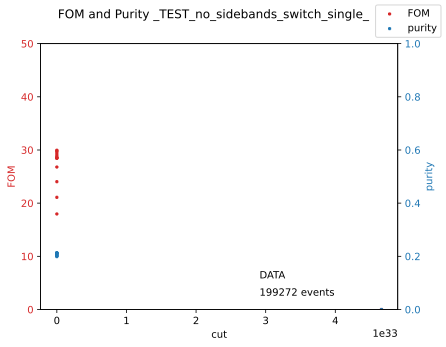

In [32]:
fig, ax1 = plt.subplots()
fig.suptitle("FOM and Purity "+ extra_info)

color = 'tab:red'
ax1.set_xlabel('cut')
ax1.scatter(cut_hist[:,0], cut_hist[:,1], label = "FOM", color = "tab:red",marker = '+', s = 10)
ax1.set_ylabel('FOM', color=color)
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_ylim([0, 50])
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('purity', color=color)  # we already handled the x-label with ax1
ax2.scatter(cut_hist[:,0], cut_hist[:,2], label = "purity", color = "tab:blue",marker = '+',s = 10)
ax2.tick_params(axis='y', labelcolor=color)
ax2.set_ylim([0, 1])
fig.legend()
fig.text(0.6,0.2,"DATA")
fig.text(0.6,0.15,f"{len(probs_data)} events")
# fig.tight_layout()  # otherwise the right y-label is slightly clipped
# plt.show()
fig.show()
# fig.savefig(FOM_pure_path)

roc_cut = 0.2 | FOM: 29.66720618244316 | purity: 0.2123369716580051


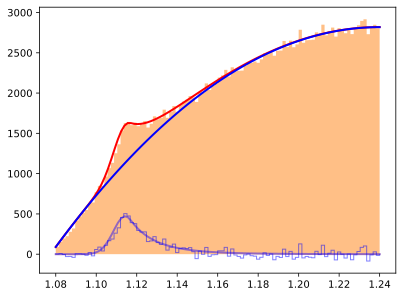

In [33]:
roc_cut =0.2
probs_data = plot_train_data
if(roc_cut == 0):
    argmax_Y = torch.max(probs_data, 1)[1]
else:
    argmax_Y = torch.tensor([1 if el>roc_cut else 0 for el in probs_data[:,1]],dtype=torch.long)

masked_mass = argmax_Y * training_data_DATA.mass
#     signal_mass = argmax_Y * testing_data_DATA.mass
signal_mass = np.array([])
for j in range(masked_mass.size()[0]):
    if(masked_mass[j] != 0):
        signal_mass = np.append(signal_mass, masked_mass[j])
# Define fit function


low_high = (1.08,1.24)
bins = 100

# hdata = np.histogram(signal_mass, range=low_high, bins=bins, density=False);
hdata = plt.hist(signal_mass, color='tab:orange', alpha=0.5, range=low_high, bins=bins, histtype='stepfilled', density=False, label='signal');

N, beta, m, loc, scale, A, B, C = 10, 1, 1.112, 1.115, 0.008, np.average(hdata[0][-10:-1]), 37, 1.24
d_N, d_beta, d_m, d_loc, d_scale, d_A, d_B, d_C = N/0.01, beta/0.1, m/0.1, loc/0.1, scale/0.01, A/10, B/0.1, C/1
parsMin = [N-d_N, beta-d_beta, m-d_m, loc-d_loc, scale-d_scale, B-d_B]
parsMax = [N+d_N, beta+d_beta, m+d_m, loc+d_loc, scale+d_scale, B+d_B]

def func(x, N, beta, m, loc, scale, B, A=A, C=C):
    return N*crystalball.pdf(-x, beta, m, -loc, scale) + A*(1 - B*(x - C)**2)

def sig(x, N, beta, m, loc, scale):
    return N*crystalball.pdf(-x, beta, m, -loc, scale)

def bg(x, B, A=A, C=C):
    return A*(1 - B*(x - C)**2)

optParams, pcov = opt.curve_fit(func, hdata[1][:-1], hdata[0], method='trf', bounds=(parsMin,parsMax))

x = np.linspace(low_high[0],low_high[1],bins)
y = hdata[0]

plt.plot(x, func(x, *optParams), color='r')
plt.plot(x, sig(x, *optParams[0:5]), color='tab:purple')
plt.plot(x, bg(x, *optParams[5:]), color='b')

# bghist = np.histogram(x, weights=y-bg(x, *optParams[5:]), bins=bins, range=low_high);
bghist = plt.hist(x, weights=y-bg(x, *optParams[5:]), bins=bins, range=low_high, histtype='step', alpha=0.5, color='b');
#     plt.savefig(histo_path)

r = np.divide(y - func(x, *optParams),np.sqrt([el if el>0 else 1 for el in func(x, *optParams)]))
chi2 = np.sum(np.square(r))
chi2ndf = chi2/len(optParams)

# Get S and N before and after? #DEBUGGING: ADDED
import scipy.integrate as integrate
mu      = optParams[3]
sigma   = optParams[4]
mmin    = mu - 2*sigma
mmax    = mu + 2*sigma


binwidth = (low_high[1]-low_high[0])/bins#KEEP!!!

bin1 = int((mmin-low_high[0])/binwidth)
bin2 = int((mmax-low_high[0])/binwidth)

integral_bghist = sum(bghist[0][bin1:bin2])

integral_tothist = sum(hdata[0][bin1:bin2])
try:
    fom = integral_bghist/np.sqrt(integral_tothist)
    purity =(integral_bghist)/integral_tothist
    cut_hist[i] = torch.tensor([roc_cut, fom, purity])
except Exception as inst:
    print(f"Caught {inst} | skipping cut #{i} = {roc_cut}")
print(f"roc_cut = {roc_cut} | FOM: {fom} | purity: {purity}")